In [3]:
import os
import numpy as np
import pandas as pd
os.environ['USE_PYGEOS'] = '0'
import geopandas as gpd

from scipy.signal import correlate
from scipy.stats import pearsonr, spearmanr
from sklearn.preprocessing import StandardScaler
from statsmodels.tsa.api import VAR
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.stattools import grangercausalitytests

import matplotlib.pyplot as plt
import seaborn as sns

# Define functions

In [4]:
# Load and merge spatial data

def load_country_level_tweets(file_dir, file_name):
  gdf_countries = gpd.read_file(file_dir + file_name + '_country.geojson', driver='GeoJSON')
  return gdf_countries

def merge_country_level_tsgi(gdf_countries, df_tsgi_country_total):
  gdf_countries = gdf_countries.merge(df_tsgi_country_total, left_on='ADMIN', right_on='NAME_0', how='left')
  gdf_countries['tweets_proportion'] = gdf_countries['tweets_count'] / gdf_countries['N']
  gdf_countries['tweets_proportion_log'] = np.log(gdf_countries['tweets_proportion'])
  gdf_countries['score_difference'] = gdf_countries['score'] - gdf_countries['SCORE']
  return gdf_countries

In [5]:
def plot_maps(gdf_countries, column_name, title, cmap='Blues'):

    fig, ax = plt.subplots(figsize=(50, 30), dpi=300)

    gdf_countries.plot(column=column_name, 
                       cmap=cmap, 
                       legend=True, 
                       legend_kwds={'shrink': 0.5, 'aspect': 20, 'pad': 0.02},
                       ax=ax)

    legend = ax.get_legend()
    if legend:
        legend.set_bbox_to_anchor((1, 0.5))
        legend.get_frame().set_linewidth(0.0)
        legend.get_frame().set_facecolor('none')
        legend.set_title('Proportion of Tweets with Blockchain', prop={'size': 25})
        for text in legend.get_texts():
            text.set_fontsize(30)

    ax.set_title(title, fontsize=35)

    plt.savefig('./figures/spatial/maps/' + title.lower().replace(' ', '_') + '.png', bbox_inches='tight')
    plt.show()


# Load data

In [6]:
# Load the dictionary

dictionary = pd.read_excel('./dictionary/dictionary.xlsx', sheet_name=None)

In [7]:
# Load the TSGI data

tsgi_world = './data/tsgi/tsgi_world.csv'
tsgi_country = './data/tsgi/tsgi_country.csv'

df_tsgi_world = pd.read_csv(tsgi_world)
df_tsgi_country = pd.read_csv(tsgi_country)

df_tsgi_world['DATE'] = pd.to_datetime(df_tsgi_world['DATE'])
df_tsgi_world.set_index('DATE', inplace=True)
df_tsgi_world = df_tsgi_world.sort_values(by='DATE')

df_tsgi_country['DATE'] = pd.to_datetime(df_tsgi_country['DATE'])
df_tsgi_country.set_index('DATE', inplace=True)
df_tsgi_country = df_tsgi_country.sort_values(by='DATE')
df_tsgi_country.loc[df_tsgi_country['NAME_0'] == 'United States', 'NAME_0'] = 'United States of America'  # Modify the country name to match data

df_tsgi_world = df_tsgi_world.dropna()  # world-level daily data
df_tsgi_country = df_tsgi_country.dropna()  # country-level daily data

df_tsgi_world_monthly = df_tsgi_world.resample('M').agg({'N': 'sum', 'SCORE': 'mean'})  # world-level monthly data
df_tsgi_country_monthly = df_tsgi_country.resample('M').agg({'N': 'sum', 'SCORE': 'mean'})  # country-level monthly data
df_tsgi_country_total = df_tsgi_country.groupby('NAME_0').agg({'N': 'sum', 'SCORE': 'mean'}).reset_index()  # country-level total data

In [8]:
# Load the crypto price data

crypto_dir = './data/crypto_price/'
files = os.listdir(crypto_dir)

crypto_dfs = {}   # daily crypto price

for file in files:
  crypto_df = pd.read_csv(os.path.join(crypto_dir, file))
  ## Set timestamp (timeClose) as index
  crypto_df['timestamp'] = pd.to_datetime(crypto_df['timestamp']).dt.date
  crypto_df.set_index('timestamp', inplace=True)
  crypto_df.index = pd.to_datetime(crypto_df.index)
  crypto_name = file.split('_')[0]
  crypto_dfs[crypto_name] = crypto_df

## Sort crypto_dfs
crypto_dfs = {key: crypto_dfs[key] for key in sorted(crypto_dfs.keys(), key=lambda k: crypto_dfs[k].index.min())}
## Rename columns in crypto_dfs
for key in crypto_dfs.keys():
  crypto_dfs[key].columns = [key + '_' + i for i in crypto_dfs[key].columns]

crypto_dfs_monthly = {}   # monthly crypto price

for key in crypto_dfs:
  crypto_df = crypto_dfs[key]
  crypto_df.index = pd.to_datetime(crypto_df.index)
  df_monthly = crypto_df.resample('M').mean(numeric_only=True)
  crypto_dfs_monthly[key] = df_monthly

# Spatial analysis

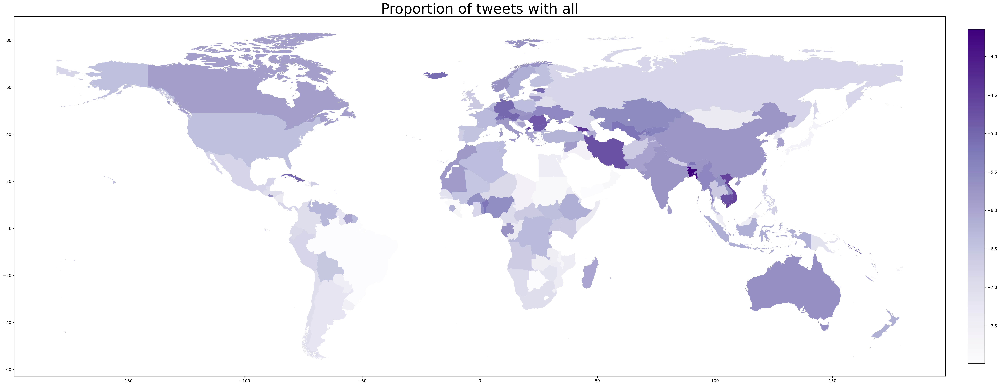

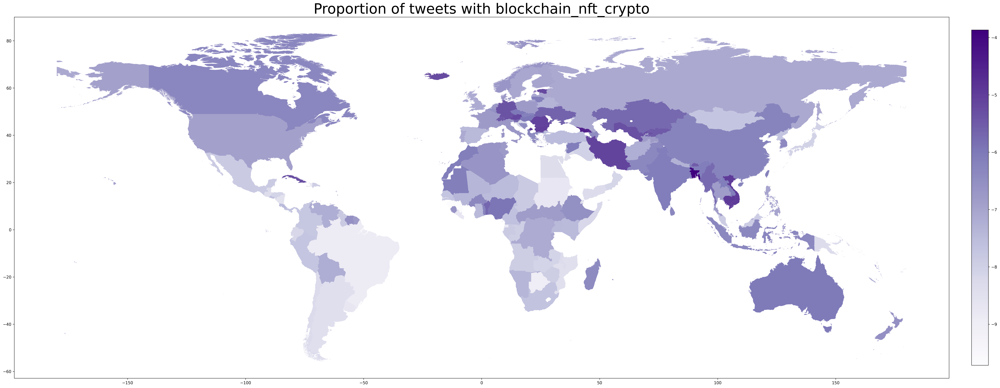

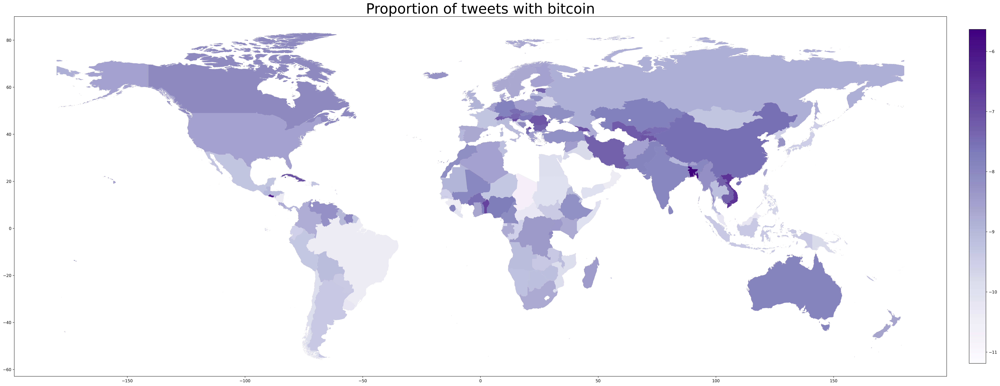

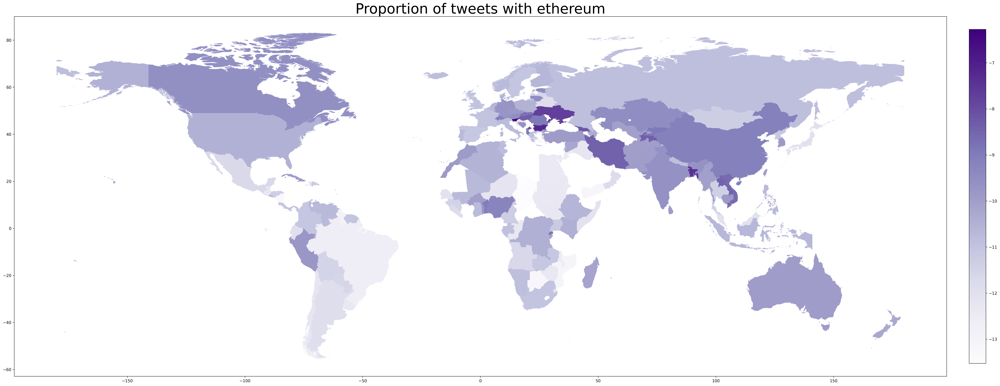

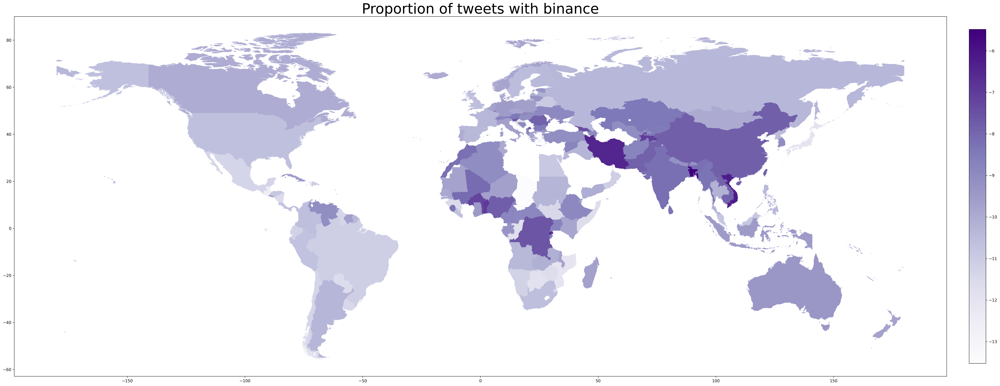

...

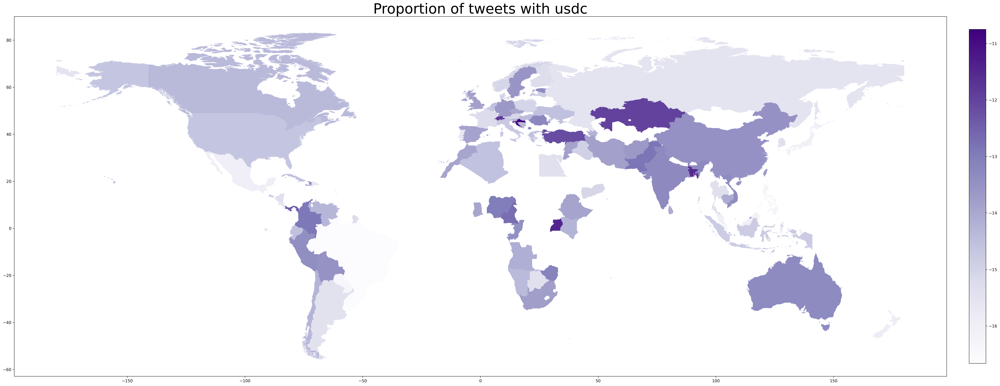

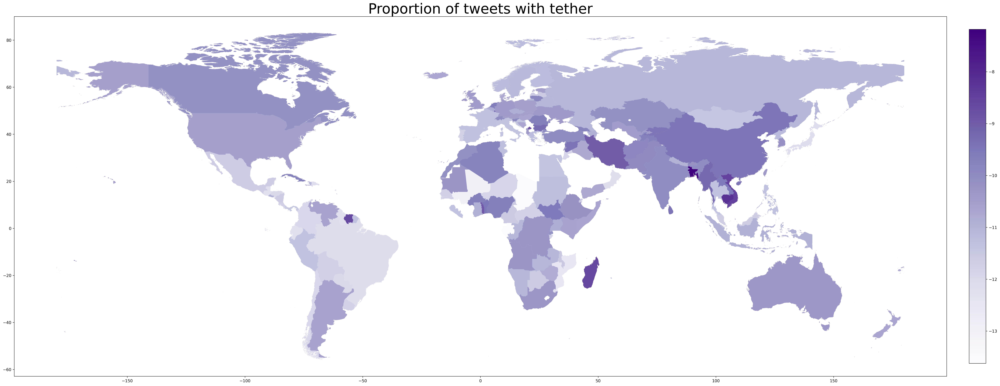

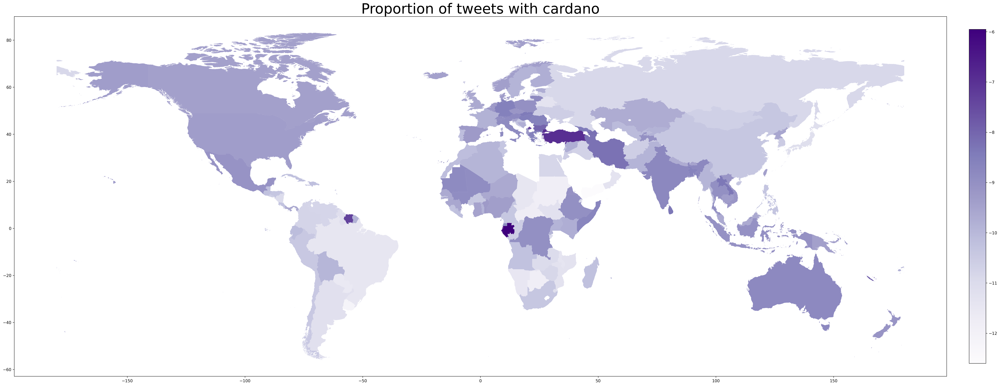

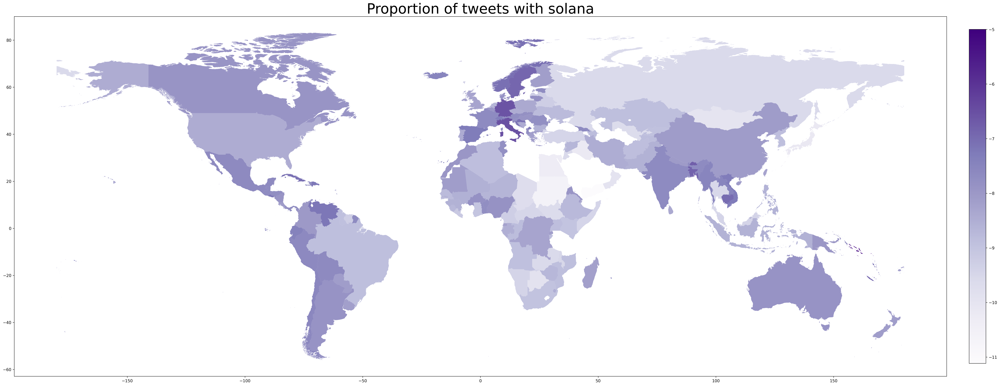

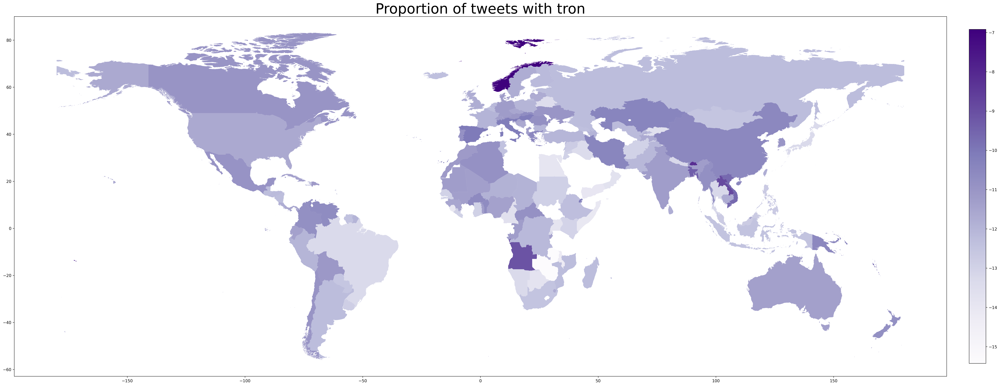

In [9]:
# Load the spatially aggregated tweets data
file_dir = './data/tweets_aggregation/'

topics_options = {
    'All': list(dictionary.keys()),
    'Blockchain_NFT_Crypto': ['blockchain', 'NFT', 'crypto'],
    'Bitcoin': ['Bitcoin'],
    'Ethereum': ['Ethereum'], 
    'Binance': ['Binance'], 
    'Dogecoin': ['Dogecoin'], 
    'Ripple': ['Ripple'], 
    'Litecoin': ['Litecoin'], 
    'USDC': ['USDC'], 
    'Tether': ['Tether'], 
    'Cardano': ['Cardano'], 
    'Solana': ['Solana'], 
    'TRON': ['TRON']
}

for key in topics_options.keys():

  # Load the spatially aggregated tweets for each topic
  file_name = key.lower()
  gdf_topic = load_country_level_tweets(file_dir, file_name)
  gdf_topic = merge_country_level_tsgi(gdf_topic, df_tsgi_country_total)
  
  # Plot maps
  title =  'Proportion of tweets with ' + key.lower()
  plot_maps(gdf_topic, 'tweets_proportion_log', title, cmap='Purples')